Le but de ce notebook est de montrer que l'on peut facilement jouer avec des données géographiques, notamment en traçant des cartes ou des graphes.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from mpl_toolkits.basemap import Basemap
import pycountry # permet de faire le mapping des noms de pays vers les noms ISO et inversement
import plotly.express as px

# I - Lecture et préparation du dataset

In [2]:
terror = pd.read_csv('../data/globalterrorismdb_0617dist.csv', encoding='ISO-8859-1')
terror.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'}, inplace=True)
terror = terror[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
terror['Casualties'] = terror['Killed'] + terror['Wounded']
terror.head(3)

/anaconda3/envs/formation/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning:

Columns (4,6,31,33,53,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.



,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,Casualties
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.432608,-99.133207,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0


In [3]:
print(f"Pays avec le nombre d'attaques terroristes le plus élevé: {terror['Country'].value_counts().index[0]}")
print(f"Régions avec le nombre d'attaques terroristes le plus élevé: {terror['Region'].value_counts().index[0]}")
print(f"Nombre maximum de personnes tuées en une attaque: {terror['Killed'].max()}")

Pays avec le nombre d'attaques terroristes le plus élevé: Iraq
Régions avec le nombre d'attaques terroristes le plus élevé: Middle East & North Africa
Nombre maximum de personnes tuées en une attaque: 1500.0


Grâce à PyCountries, on va récupérer les codes ISO des pays pour pouvoir les utiliser dans nos cartes.

In [4]:
map_countries = {}
for country in pycountry.countries:
    map_countries[country.name] = country.alpha_3
    
inv_map_countries = {v: k for k, v in map_countries.items()}

terror['iso_alpha'] = [map_countries.get(country, 'Unknown code') for country in terror['Country']]

On définit d'autres mapping, qui nous permettront d'obtenir :
- une région à partir d'un pays (et inversement)
- un continent à partir d'une région (et inversement)

Cela nous servira un peu plus tard lorsque nous agrègerons les données.

In [5]:
map_region_country = terror.groupby('Region')['Country'].apply(lambda x: list(set(x.tolist()))).to_dict()
inv_map_region_country = {value: key for key in map_region_country for value in map_region_country[key]}

In [6]:
map_continent_region = {'Asia': ['South Asia', 'East Asia', 'Central Asia', 'Southeast Asia'],
                        'Europe': ['Eastern Europe', 'Western Europe'],
                        'Africa': ['Middle East & North Africa', 'Sub-Saharan Africa'],
                        'South America': ['South America', 'Central America & Caribbean'],
                        'North America': ['North America'],
                        'Oceania': ['Australasia & Oceania']}
inv_map_continent_region = {value: key for key in map_continent_region for value in map_continent_region[key]}

# II - Place aux graphes animés

## 1 - De belles cartes

Pour ce graphe, on agrège le nombre de morts par pays (iso_alpha), puis on affiche le tout sur une carte du monde.  
Chaque point, plus ou moins gros, représente le nombre de morts par pays toutes années confondues, par des attentats.

In [7]:
df_terror_sum_by_region = terror[['Killed','iso_alpha']].groupby('iso_alpha').sum()
df_terror_sum_by_region.reset_index(inplace=True)
df_terror_sum_by_region['Country'] = [inv_map_countries.get(iso_alpha, 'Unknown code') for iso_alpha in df_terror_sum_by_region['iso_alpha']]
df_terror_sum_by_region.head()

,iso_alpha,Killed,Country
0,AFG,33146.0,Afghanistan
1,AGO,3036.0,Angola
2,ALB,42.0,Albania
3,AND,0.0,Andorra
4,ARE,123.0,United Arab Emirates


In [8]:
fig = px.scatter_geo(df_terror_sum_by_region, 
                     locations='iso_alpha', 
                     color='Country',
                     hover_name='Country', 
                     size='Killed',
                     projection='natural earth',
                     title='Nombre de morts par pays (1970-2016)')
fig.show()

Avec Plotly Express, on peut facilement animer les graphes ; ici, on va effectuer le même agrégat que précédemment mais en ajoutant cette fois Year dans la clause groupby, ce qui nous permettre d'utiliser l'année à chaque pas de temps.

In [9]:
df_terror_sum_by_region_by_year = terror[['Killed', 'Wounded', 'Casualties', 'iso_alpha', 'Year']].groupby(['iso_alpha', 'Year']).sum()
df_terror_sum_by_region_by_year.reset_index(inplace=True)

Les 3 lignes suivantes nous permettent, grâce au mapping effectué au début du notebook, de retrouver les pays, régions et continents à partir du code ISO.

In [10]:
df_terror_sum_by_region_by_year['Country'] = [inv_map_countries.get(iso_alpha, 'Unknown code') for iso_alpha in df_terror_sum_by_region_by_year['iso_alpha']]
df_terror_sum_by_region_by_year['Region'] = [inv_map_region_country.get(country, 'Unknown code') for country in df_terror_sum_by_region_by_year['Country']]
df_terror_sum_by_region_by_year['Continent'] = [inv_map_continent_region.get(region, 'Unknown code') for region in df_terror_sum_by_region_by_year['Region']]

Enfin, on trie les données par rapport à l'année.

In [11]:
df_terror_sum_by_region_by_year = df_terror_sum_by_region_by_year.sort_values('Year')
df_terror_sum_by_region_by_year.head()

,iso_alpha,Year,Killed,Wounded,Casualties,Country,Region,Continent
585,COL,1970,0.0,0.0,0.0,Colombia,South America,South America
1193,GTM,1970,2.0,0.0,2.0,Guatemala,Central America & Caribbean,South America
1752,LBN,1970,0.0,0.0,0.0,Lebanon,Middle East & North Africa,Africa
379,BRA,1970,2.0,1.0,3.0,Brazil,South America,South America
2470,PRY,1970,1.0,1.0,2.0,Paraguay,South America,South America


In [12]:
fig = px.scatter_geo(df_terror_sum_by_region_by_year, 
                     locations='iso_alpha', 
                     color='Country',
                     hover_name='Country', 
                     size='Killed', 
                     animation_frame='Year',
                     projection='natural earth')
fig.show()

On peut changer la représentation en utilisant cette fois une carte choroplèthe, qui colorera cette fois tous les pays selon le nombre de morts.

In [13]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='natural earth',
                    range_color=[0, df_terror_sum_by_region_by_year['Killed'].max()],
                    color_continuous_scale='Reds')
fig.show()

Le graphe précédent est bien, mais on peut faire mieux au niveau de l'échelle, notamment en n'affichant les valeurs que lorsqu'il y a eu au moins un mort et en regroupant les pays où il y a eu 1000 morts et plus.

In [14]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='natural earth',
                    range_color=[1, 1000],
                    color_continuous_scale='Reds')
fig.show()

On peut aussi changer le type de projection pour bien voir que la terre est ronde :-).

In [15]:
fig = px.choropleth(df_terror_sum_by_region_by_year, 
                    locations='iso_alpha',
                    hover_name='Country', 
                    color='Killed', 
                    animation_frame='Year',
                    projection='orthographic',
                    range_color=[1, 1000],
                    color_continuous_scale='Reds')
fig.show()

Après Plotly Express, il est également possible d'utiliser Basemap de Matplotlib pour créer des cartes hautement personnalisables.  
On peut notamment changer facilement le type de projection utilisée, les longitudes et latitudes utilisées pour projeter la carte, les couleurs des pays et des océans (on peut ajouter du relief, par exemple).

Dans l'exemple suivant, on utilise la projection cylindrique de Miller, qui est similaire à la projection de Mercator mais déforme moins les pôles. On affiche un point pour chaque évènement, rouge s'il a fait moins de 50 morts et jaune s'il a fait moins de 50 morts.

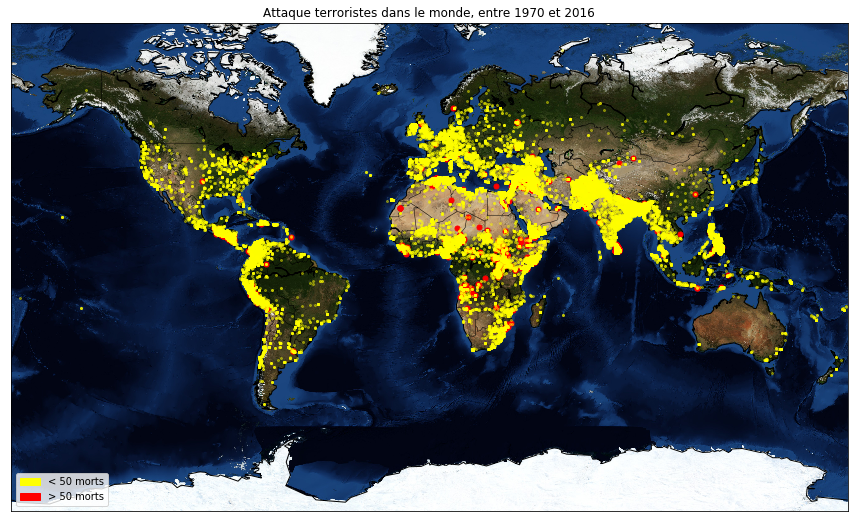

In [16]:
m3 = Basemap(projection='mill', 
             llcrnrlat=-80,
             urcrnrlat=80, 
             llcrnrlon=-180,
             urcrnrlon=180,
             lat_ts=20,
             resolution='c',
             lat_0=True,
             lat_1=True)

n_high_killed = 50

lat_high_killed = list(terror[terror['Killed']>=n_high_killed].latitude)
lon_high_killed =list(terror[terror['Killed']>=n_high_killed].longitude)
x_high_killed, y_high_killed = m3(lon_high_killed, lat_high_killed)
m3.plot(x_high_killed, y_high_killed, 'go', markersize=5, color='red')

lat_low_killed = list(terror[terror['Killed']<n_high_killed].latitude)
lon_low_killed = list(terror[terror['Killed']<n_high_killed].longitude)
x_high_killed, y_high_killed=m3(lon_low_killed, lat_low_killed)
m3.plot(x_high_killed, y_high_killed, 'go', markersize=2, color='yellow', alpha=0.4)

m3.drawcoastlines()
m3.drawcountries()
#m3.fillcontinents(lake_color='aqua')
#m3.drawmapboundary(fill_color='aqua')
fig = plt.gcf()
fig.set_size_inches(15, 9)
plt.title('Attaque terroristes dans le monde, entre 1970 et 2016')
plt.legend(loc='lower left', 
           handles=[mpatches.Patch(color='yellow', label=f'< {n_high_killed} morts'),
                    mpatches.Patch(color='red',label=f'> {n_high_killed} morts')])
m3.bluemarble()
plt.show()

## 2 - Des beaux graphes

Cet histogramme affiche le nombre de morts total, selon le type d'attaque.

In [17]:
fig = px.histogram(terror, 
                   x='AttackType', 
                   y='Killed',
                   color='AttackType',
                   histfunc='sum',
                   title="Nombre de morts selon le type d'attaque"
                  )
fig.show()

Ici, on va animer un graphe selon les années, qui représentera l'évolution du nombre de morts et de blessés par continent.  
Note :  Pour rendre le graphe plus lisible, le tick maximal sur les axes des abscisses et des ordonnées est égal à la  moitié du maximum du domaine.

In [18]:
fig = px.scatter(df_terror_sum_by_region_by_year, 
                 x='Wounded', 
                 y='Killed', 
                 animation_frame='Year', 
                 animation_group='Country',
                 size='Casualties', 
                 color='Continent', 
                 hover_name='Country', 
                 facet_col='Continent',
                 size_max=45, 
                 range_x=[0, df_terror_sum_by_region_by_year['Wounded'].max()/2], 
                 range_y=[0, df_terror_sum_by_region_by_year['Killed'].max()/2],
                 title='Evolution du nombre de blessés et de morts par continent')
         
fig.show()

Ici, on s'attache à afficher des courbes de nombre de morts par pays, chaque couleur représentant le continent du pays.

In [19]:
fig = px.line(df_terror_sum_by_region_by_year, 
              x='Year', 
              y='Killed', 
              color='Continent', 
              line_group='Country', 
              hover_name='Country',
              line_shape='spline', 
              render_mode='svg',
              title='Evolution du nombre de morts par continent')
fig.show()

Le graphe suivant permet d'afficher le nombre de morts et de blessés total par pays, chaque couleur représentant le continent du pays ; chaque point représente donc un pays.  
Il y a également une courbe qui permet, par continent, de déterminer une régression linéaire entre les blessés et les morts.  
Enfin, Il y a sur les marges, les violinplots et boxplots, respectivement des blessés et des morts.

In [20]:
fig = px.scatter(df_terror_sum_by_region_by_year, 
                 x='Wounded', 
                 y='Killed', 
                 color='Continent', 
                 marginal_x='violin',
                 marginal_y='box', 
                 trendline='ols')
fig.show()

Pour les histogrammes et le graphe de catégories parallèles, nous avons choisi de filtrer le dataset avec certains types d'attaques, de régions et de types d'arme afin de le rendre lisible.

In [21]:
chosen_attack_type = ['Assassination', 'Bombing/Explosion', 'Armed Assault']
chosen_region = ['Middle East & North Africa', 'Sub-Saharan Africa']
chosen_weapon_type = ['Firearms', 'Explosives/Bombs/Dynamite', 'Incendiary']

terror_filtered = terror[terror['AttackType'].isin(chosen_attack_type)]
terror_filtered = terror_filtered[terror_filtered['Region'].isin(chosen_region)]
terror_filtered = terror_filtered[terror_filtered['Weapon_type'].isin(chosen_weapon_type)]

In [22]:
fig = px.histogram(terror_filtered, 
             x='AttackType', 
             y='Killed', 
             color='Weapon_type', 
             barmode='group', 
             facet_row='Region',
             title="Nombre de morts par type d'attaques et armes, selon les régions d'Afrique")
fig.show()

In [23]:
fig = px.parallel_categories(terror_filtered,
                             dimensions=['AttackType', 'Region', 'Weapon_type'],
                             color='Year',
                             title="Nombre d'évènements par année selon le type d'attaque, la région et le type d'arme")
fig.show()

Crédits : Léa Naccache et Aurélien Massiot, OCTO Technology.